In [1]:
import os
import sys
import time
import argparse
import numpy as np
import xml.etree.ElementTree as ET

import torch
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision import datasets
from torchvision import transforms

import cv2
from PIL import Image
import matplotlib.pyplot as plt

import _init_paths
from opts import opts
from detectors.detector_factory import detector_factory

from my_utils import *
from policy_network import *
from utils import *
from datasets import *
import kcftracker
from siamfc import *

In [2]:
parser = argparse.ArgumentParser()
opt = parser.parse_args('')
opt.gpus = [0]
opt.device = 'cuda'
opt.arch = 'resdcn_18'
opt.heads = {'hm': 80, 'wh': 2, 'reg': 2}
opt.head_conv = 64
opt.load_model = '../models/ctdet_coco_resdcn18.pth'
opt.mean = np.array([0.408, 0.447, 0.47])
opt.std = np.array([0.289, 0.274, 0.278])
opt.num_classes = 80
opt.test_scales = [1.0]
opt.dataset = 'coco'
opt.debug = 0
opt.debugger_theme = 'white'
opt.fix_res = True
opt.input_h = 416
opt.input_w = 416
opt.flip_test = False
opt.down_ratio = 4
opt.reg_offset = True
opt.K = 100
opt.nms = True

Detector = detector_factory['ctdet']
detector = Detector(opt)

image = cv2.imread('../../yolov3/data/samples/bus.jpg')
ret = detector.run(image)

Creating model...
=> loading pretrained model https://download.pytorch.org/models/resnet18-5c106cde.pth
=> init deconv weights from normal distribution
loaded ../models/ctdet_coco_resdcn18.pth, epoch 140


In [3]:
def load_classes(path):
    with open(path, 'r') as f:
        names = f.read().split('\n')
    return list(filter(None, names))


def plot_one_box(x, img, color=None, label=None, line_thickness=None):
    # Plots one bounding box on image img
    tl = line_thickness or round(0.002 * max(img.shape[0:2])) + 1
    color = color or [random.randint(0, 255) for _ in range(3)]
    c1, c2 = (int(x[0]), int(x[1])), (int(x[2]), int(x[3]))
    cv2.rectangle(img, c1, c2, color, thickness=tl)
    if label:
        tf = max(tl - 1, 1)
        t_size = cv2.getTextSize(label, 0, fontScale=tl / 3, thickness=tf)[0]
        c2 = c1[0] + t_size[0], c1[1] - t_size[1] - 3
        cv2.rectangle(img, c1, c2, color, -1)
        cv2.putText(img, label, (c1[0], c1[1] - 2), 0, tl / 3, [225, 255, 255], thickness=tf, lineType=cv2.LINE_AA)


image_folder = "../../yolov3/data/samples"
class_path = "../../yolov3/data/coco.names"

conf_thres = 0.5
img_size = 416

# device = torch.device("cpu")
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
Tensor = torch.cuda.FloatTensor if torch.cuda.is_available() else torch.FloatTensor


dataloader = LoadImages(image_folder, img_size=img_size)
classes = load_classes(class_path)
colors = [[random.randint(0, 255) for _ in range(3)] for _ in range(len(classes))]

image 1/11 ../../yolov3/data/samples/bus.jpg: 

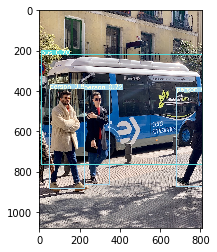

image 2/11 ../../yolov3/data/samples/dog.jpg: 

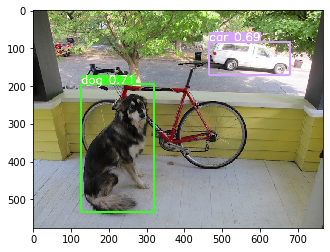

image 3/11 ../../yolov3/data/samples/eagle.jpg: 

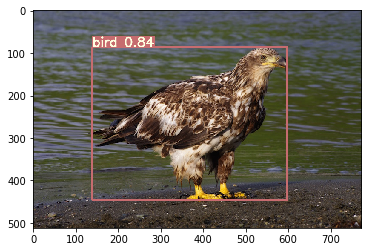

image 4/11 ../../yolov3/data/samples/field.jpg: 

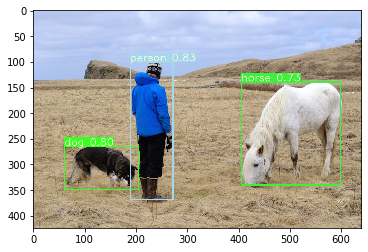

image 5/11 ../../yolov3/data/samples/giraffe.jpg: 

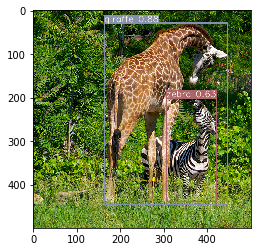

image 6/11 ../../yolov3/data/samples/herd_of_horses.jpg: 

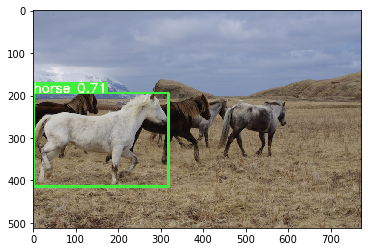

image 7/11 ../../yolov3/data/samples/messi.jpg: 

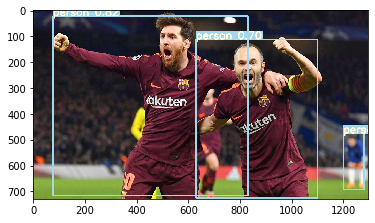

image 8/11 ../../yolov3/data/samples/person.jpg: 

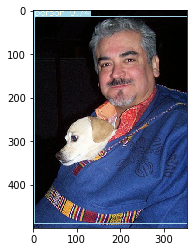

image 9/11 ../../yolov3/data/samples/room.jpg: 

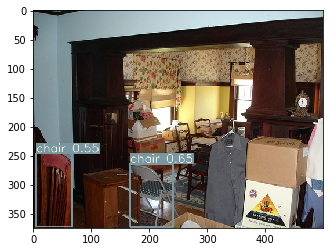

image 10/11 ../../yolov3/data/samples/street.jpg: 

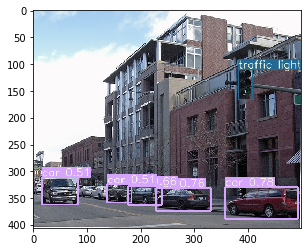

image 11/11 ../../yolov3/data/samples/zidane.jpg: 

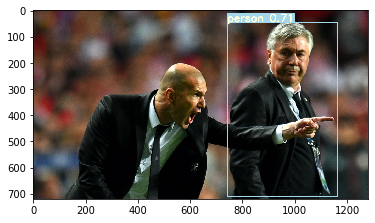

In [4]:
for i, (path, img, im0, vid_cap) in enumerate(dataloader):
    t = time.time()

    # Get detections
    ret = detector.run(im0)['results']
    
    for j in range(1, opt.num_classes+1):
        for bbox in ret[j]:
            if bbox[4] > conf_thres:
                label = '%s %.2f' % (classes[(j-1)], bbox[4])
                plot_one_box(bbox[:4], im0, label=label, color=colors[j % len(colors)])
                
    plt.imshow(im0[:,:,::-1])
    plt.show()

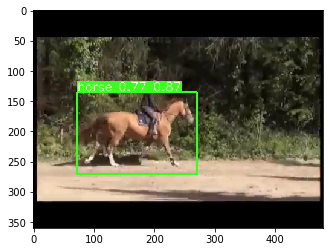

100
number of objects = 2
avg fps = 119.23083774675925
avg detection interval = 9.4375


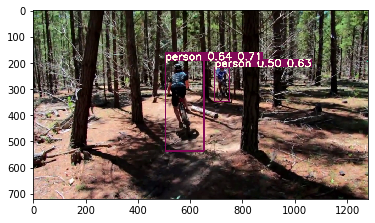

100
number of objects = 1
avg fps = 36.848360905800064
avg detection interval = 9.705882352941176


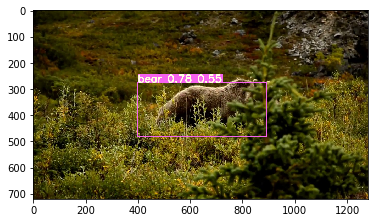

100


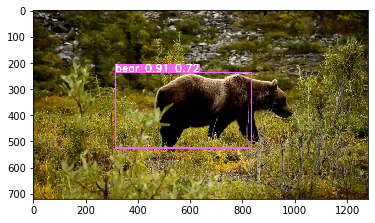

200


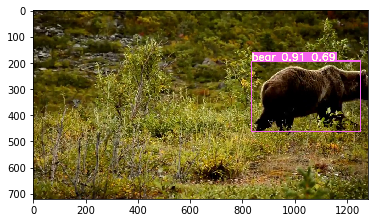

300


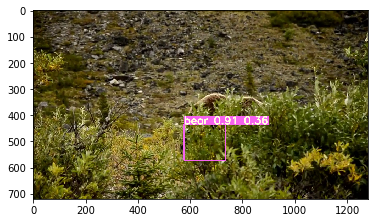

400
number of objects = 0
avg fps = 53.710342631668205
avg detection interval = 9.951219512195122


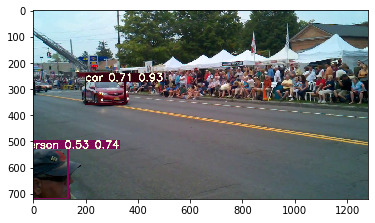

100


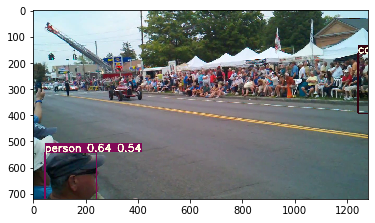

200


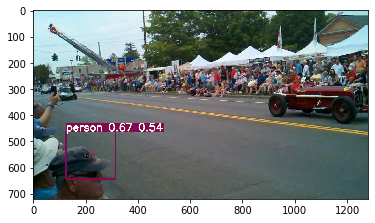

300


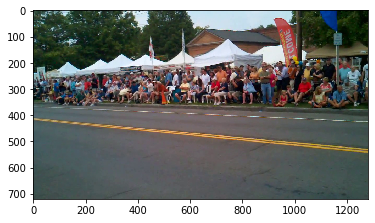

400


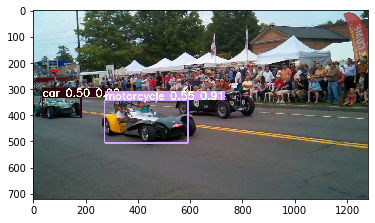

500


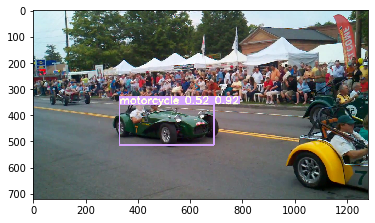

600


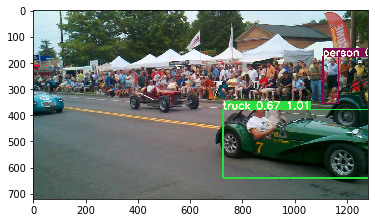

700


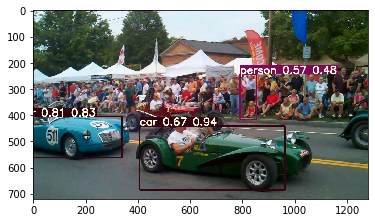

800


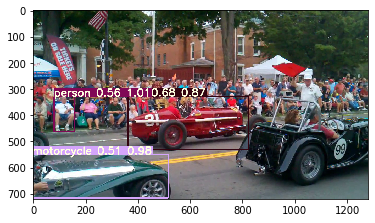

900
number of objects = 3
avg fps = 47.84926476289326
avg detection interval = 10.0


In [8]:
data_dir = "../../data/ILSVRC2015/Data/VID/snippets/"

videos = ['horse', 'bicycle', 'bear', 'cars']

for video in videos:

    if video == 'street':
        video_path = data_dir + "test/ILSVRC2015_test_00145000.mp4"
    elif video == 'horse':
        video_path = data_dir + "test/ILSVRC2015_test_00254002.mp4"
    elif video == 'tiger':
        video_path = data_dir + "test/ILSVRC2015_test_00021002.mp4"
    elif video == 'bicycle':
        video_path = data_dir + "val/ILSVRC2015_val_00124001.mp4"
    elif video == 'men':
        video_path = data_dir + "val/ILSVRC2015_val_00073000.mp4"
    elif video == 'bear':
        video_path = data_dir + "val/ILSVRC2015_val_00161000.mp4"
    elif video == 'cars':
        video_path = data_dir + "val/ILSVRC2015_val_00107000.mp4"
    elif video == 'airplanes':
        video_path = data_dir + "train/ILSVRC2015_VID_train_0003/ILSVRC2015_train_01000001.mp4"
        
    vid             = cv2.VideoCapture(video_path)    
    video_FourCC    = int(vid.get(cv2.CAP_PROP_FOURCC))
    video_fps       = vid.get(cv2.CAP_PROP_FPS)
    video_size      = (int(vid.get(cv2.CAP_PROP_FRAME_WIDTH)),
                        int(vid.get(cv2.CAP_PROP_FRAME_HEIGHT)))


    conf_thres = 0.5
    iou_thres = 0.5
    max_interval = 15
    tracking_threshold = 0.5

    output_path = '../../videos/ctnet_{}_kcf_10.avi'.format(video)
    out = cv2.VideoWriter(output_path, cv2.VideoWriter_fourcc('M','J','P','G'), video_fps, video_size)


    boxes = []
    trackers = []

    frame_i = 0
    detect_frames = 0
    total_inference_time = 0

    while True:
        _, frame = vid.read()    
        if frame is None:
            break

        prev_time = time.time()

        # Scheduling
        if frame_i == 0:
            boxes = []
            trackers = []
            keyframe = True
            detect = True
            detect_interval = max_interval
            
        elif last_detect < detect_interval:
            keyframe = False
            detect = keyframe
            
        else:
            keyframe = False
            detect = True
        
        
        # Tracking
        track = True
        if track:
            for i in range(len(boxes)):
                peak_value, box = trackers[i].update(frame[:,:,::-1])
                x1, y1, x2, y2 = from_tracking_box(box)
                boxes[i][-2] = peak_value
                boxes[i][:4] = np.array([x1, y1, x2, y2])
                if peak_value < tracking_threshold:
                    keyframe = True
                    detect = True
        
        
        if keyframe:
            detect_interval = 2
        elif detect:
            detect_interval = detect_interval*2 if detect_interval*2 < max_interval else max_interval

        keyframe = False
        detect = frame_i % 10 == 0
        # detect_interval = max_interval
        
        frame_i += 1
        detect_frames += detect
        last_detect = 1 if detect else last_detect + 1
            
            
        # Detection
        if detect:
            boxes_new = [] 
            ret = detector.run(frame)['results']
            for j in range(1, opt.num_classes+1):
                for bbox in ret[j]:
                    boxes_new.append(np.append(bbox, j-1))
            boxes_new.sort(key=lambda x: -x[4])
                            
            boxes = update_bbox(boxes, boxes_new, conf_thres, merge=track)
                
            if track:
                trackers = []
                for box in boxes:
                    trackers.append(kcftracker.KCFTracker(False, True, True))
                    trackers[-1].init(to_tracking_box(box[:4]), frame[:,:,::-1])
                    #trackers.append(TrackerSiamFC(net_path='model.pth'))
                    #trackers[-1].init(frame[:,:,::-1], to_tracking_box(box[:4]))


        # Compute inference time
        inference_time = time.time() - prev_time
        if frame_i != 0:
            total_inference_time += inference_time


        # Write frame to output video
        for x1, y1, x2, y2, conf, *cls_conf, track_score, cls in boxes:
            label = '%s %.2f %.2f' % (classes[int(cls)], conf, track_score)
            plot_one_box([x1, y1, x2, y2], frame, label=label, color=colors[int(cls)])

        if keyframe:
            plot_one_box([3, 3, frame.shape[1]-3, frame.shape[0]-3], frame, label='', color=[0,0,255])

        out.write(frame)


        # Plot results
        if frame_i % 100 == 0:
            result = Image.fromarray(frame[:,:,::-1])
            fig, ax = plt.subplots(1)
            ax.imshow(result)
            plt.show()
            print(frame_i)


    print('number of objects =', len(boxes))
    print('avg fps =', (frame_i-1) / total_inference_time)
    print('avg detection interval =', frame_i / detect_frames)

In [5]:
class_ids = ['n02691156', 'n02419796', 'n02131653', 'n02834778',
             'n01503061', 'n02924116', 'n02958343', 'n02402425',
             'n02084071', 'n02121808', 'n02503517', 'n02118333',
             'n02510455', 'n02342885', 'n02374451', 'n02129165',
             'n01674464', 'n02484322', 'n03790512', 'n02324045',
             'n02509815', 'n02411705', 'n01726692', 'n02355227',
             'n02129604', 'n04468005', 'n01662784', 'n04530566',
             'n02062744', 'n02391049']

class_names = ['airplane', 'antelope', 'bear', 'bicycle',
               'bird', 'bus', 'car', 'cow',
               'dog', 'cat', 'elephant', 'fox',
               'giant_panda', 'hamster', 'horse', 'lion',
               'lizard', 'monkey', 'motorcycle', 'rabbit',
               'red_panda', 'sheep', 'snake', 'squirrel',
               'tiger', 'train', 'turtle', 'watercraft',
               'whale', 'zebra']

id2idx = {id:idx for idx, id in enumerate(class_ids)}

valid_classes = [0,2,3,4,5,6,7,8,9,10,14,18,21,25]

coco_classes = [4, None, 21, 1,
               14, 5, 2, 19,
               16, 15, 20, None,
               None, None, 17, None,
               None, None, 3, None,
               None, 18, None, None,
               None, 6, None, None,
               None, None]

coco2imgnet = {i:None for i in range(80)}
for idx, cls in enumerate(coco_classes):
    if cls:
        coco2imgnet[cls] = idx

ILSVRC2015_val_00001000/000000 1393
[0.3333333333333333]


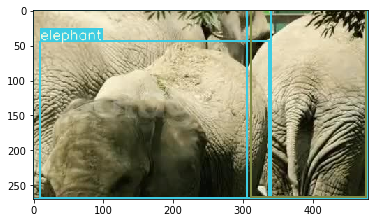

ILSVRC2015_val_00006000/000000 2585
[0.409911580808635]


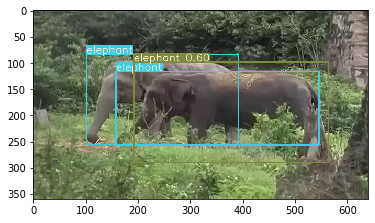

ILSVRC2015_val_00006001/000000 2645
[0.41770860140571364]


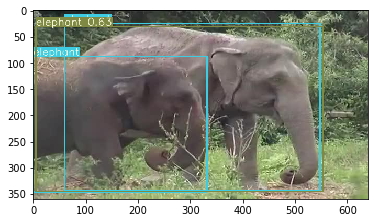

ILSVRC2015_val_00006002/000000 2765
[0.5066455854270624]


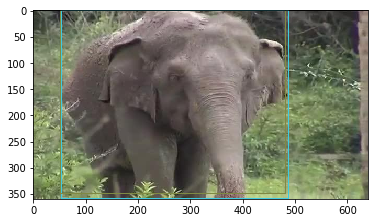

ILSVRC2015_val_00006003/000000 2835
[0.5309505046354113]


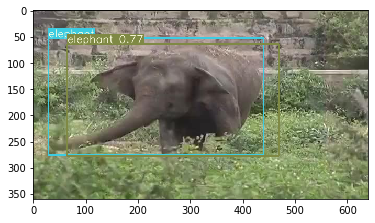

ILSVRC2015_val_00006004/000000 2915
[0.5561595282434693]


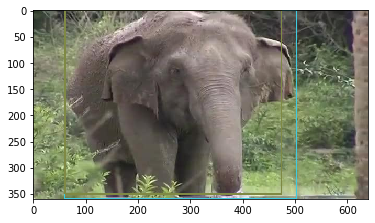

ILSVRC2015_val_00006005/000000 2975
[0.5734617545434755]


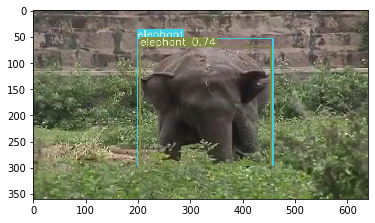

ILSVRC2015_val_00007000/000000 3103
[1.0, 0.5904844845179413]


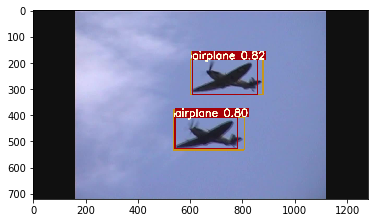

ILSVRC2015_val_00007001/000000 3202
[0.4374252213448194, 0.5904844845179413]


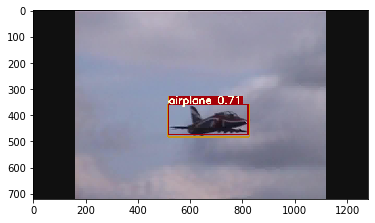

ILSVRC2015_val_00007002/000000 3350
[0.5484661585283741, 0.5904844845179413]


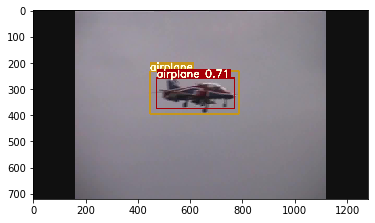

ILSVRC2015_val_00007003/000000 3444
[0.6417233560090703, 0.5904844845179413]


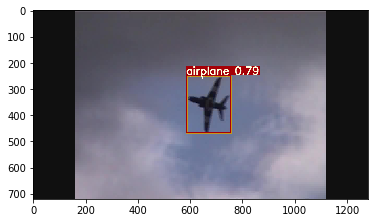

ILSVRC2015_val_00007004/000000 3552
[0.6839595565137606, 0.5904844845179413]


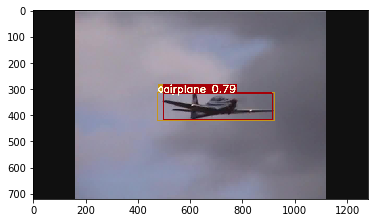

ILSVRC2015_val_00007005/000000 3674
[0.7277597197013649, 0.5904844845179413]


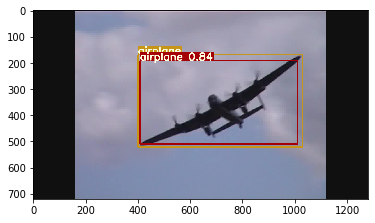

ILSVRC2015_val_00007006/000000 3896
[0.7885580130235463, 0.5904844845179413]


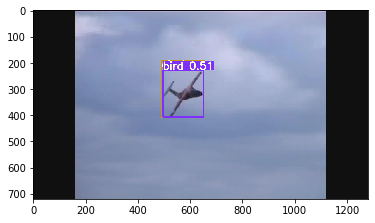

ILSVRC2015_val_00007007/000000 4139
[0.778923270516533, 0.5904844845179413]


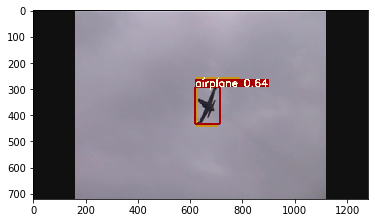

ILSVRC2015_val_00007008/000000 4279
[0.8000005864913449, 0.5904844845179413]


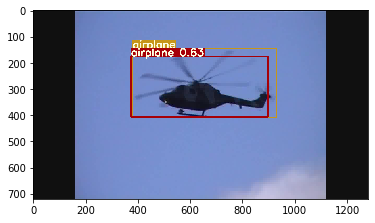

ILSVRC2015_val_00007009/000000 4378
[0.8142895392278955, 0.5904844845179413]


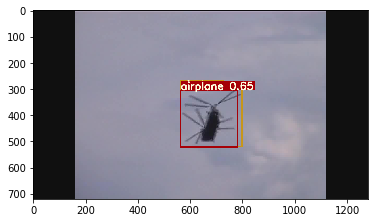

ILSVRC2015_val_00007010/000000 4642
[0.8123684084438259, 0.5904844845179413]


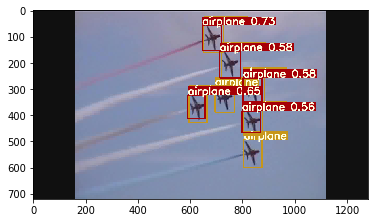

ILSVRC2015_val_00007011/000000 4786
[0.8186560710243401, 0.5904844845179413]


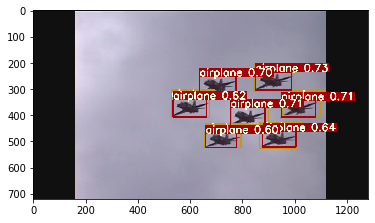

ILSVRC2015_val_00007012/000000 4926
[0.748126903105439, 0.5904844845179413]


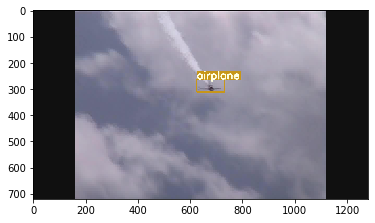

ILSVRC2015_val_00007013/000000 5117
[0.7453254453890614, 0.5904844845179413]


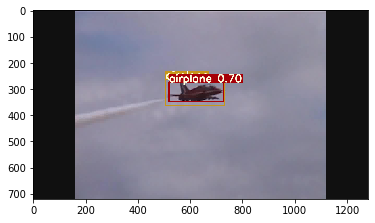

ILSVRC2015_val_00007014/000000 5253
[0.7441880808497376, 0.5904844845179413]


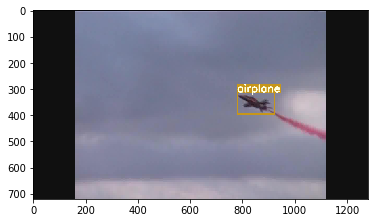

ILSVRC2015_val_00007015/000000 5426
[0.7432277270262482, 0.5904844845179413]


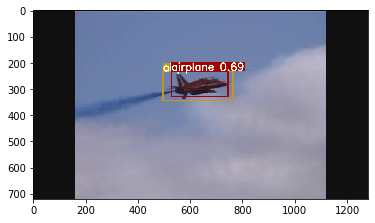

ILSVRC2015_val_00007016/000000 5563
[0.7460836716137929, 0.5904844845179413]


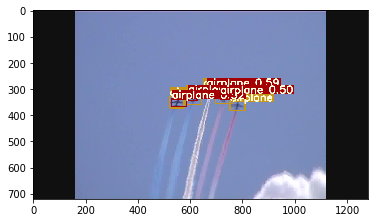

ILSVRC2015_val_00007017/000000 5895
[0.6735075501452921, 0.5904844845179413]


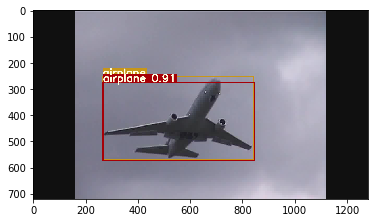

ILSVRC2015_val_00007018/000000 6199
[0.6861434053742377, 0.5904844845179413]


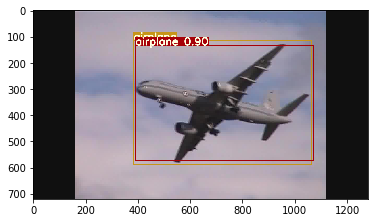

ILSVRC2015_val_00007019/000000 6416
[0.6933791277765453, 0.5904844845179413]


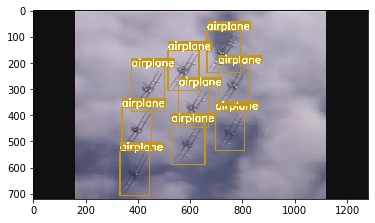

ILSVRC2015_val_00007020/000000 6546
[0.6904536082211712, 0.5904844845179413]


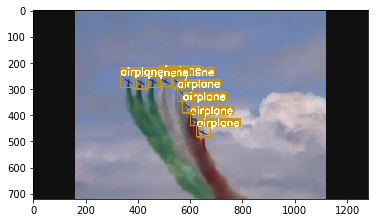

ILSVRC2015_val_00007021/000000 6604
[0.6467042019183341, 0.5904844845179413]


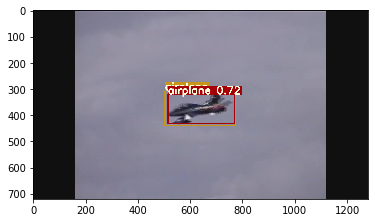

ILSVRC2015_val_00007022/000000 6640
[0.6460203992106872, 0.5904844845179413]


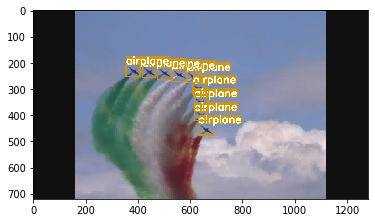

ILSVRC2015_val_00007023/000000 6686
[0.6154187641859181, 0.5904844845179413]


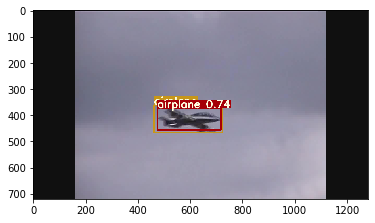

ILSVRC2015_val_00007024/000000 6749
[0.6156543587595927, 0.5904844845179413]


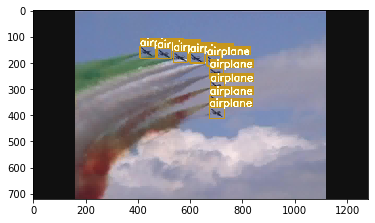

ILSVRC2015_val_00007025/000000 6779
[0.5975806267671376, 0.5904844845179413]


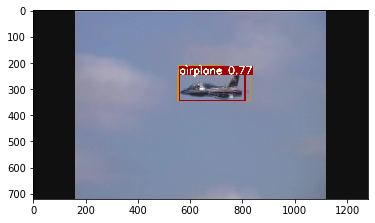

ILSVRC2015_val_00007026/000000 6841
[0.5982173470358839, 0.5904844845179413]


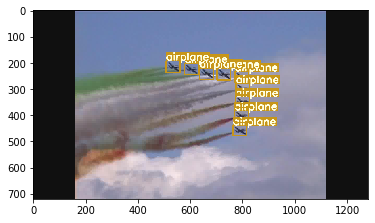

ILSVRC2015_val_00007027/000000 6860
[0.5877328832323628, 0.5904844845179413]


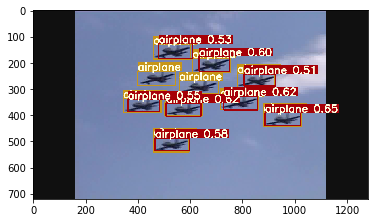

ILSVRC2015_val_00007028/000000 7015
[0.5515851653419246, 0.5904844845179413]


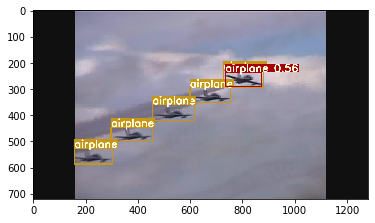

ILSVRC2015_val_00007029/000000 7219
[0.5585190386678993, 0.5904844845179413]


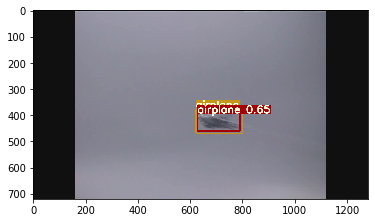

ILSVRC2015_val_00007030/000000 7351
[0.5599148497332799, 0.5904844845179413]


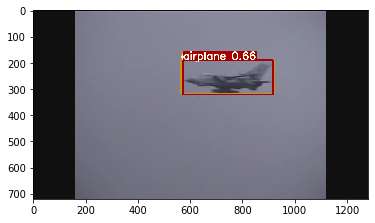

ILSVRC2015_val_00007031/000000 7648
[0.5567158983283398, 0.5904844845179413]


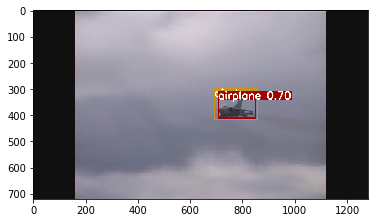

ILSVRC2015_val_00007032/000000 7843
[0.5580653585821005, 0.5904844845179413]


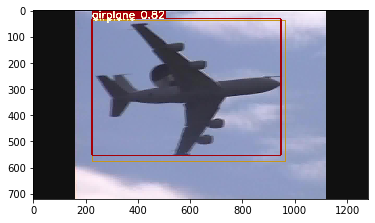

ILSVRC2015_val_00007033/000000 7972
[0.5617337180987279, 0.5904844845179413]


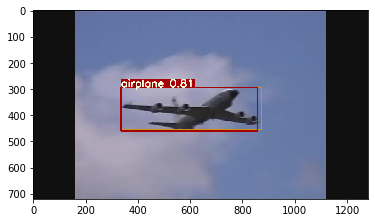

ILSVRC2015_val_00007034/000000 8272
[0.5703352560021828, 0.5904844845179413]


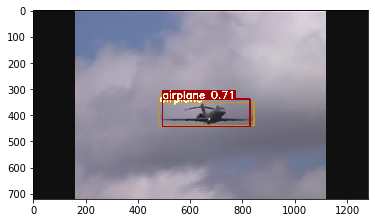

ILSVRC2015_val_00007035/000000 8535
[0.5771561289248308, 0.5904844845179413]


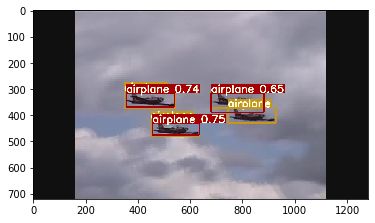

ILSVRC2015_val_00007036/000000 8725
[0.5765831988382301, 0.5904844845179413]


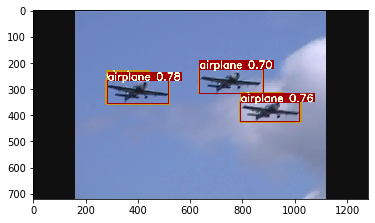

ILSVRC2015_val_00007037/000000 8890
[0.5805494966377693, 0.5904844845179413]


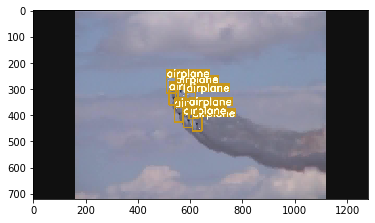

ILSVRC2015_val_00007038/000000 9186
[0.554652037787253, 0.5904844845179413]


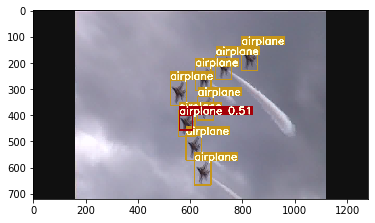

ILSVRC2015_val_00007039/000000 9351
[0.5551754936658009, 0.5904844845179413]


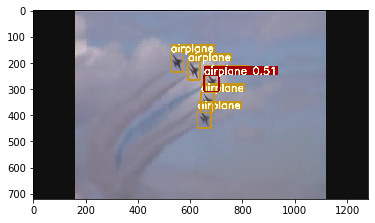

ILSVRC2015_val_00007040/000000 9589
[0.5715785634739203, 0.5904844845179413]


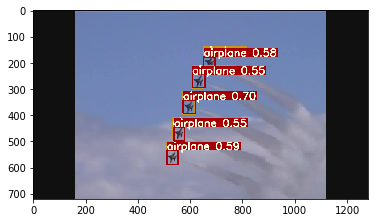

ILSVRC2015_val_00007041/000000 9729
[0.5833730985001724, 0.5904844845179413]


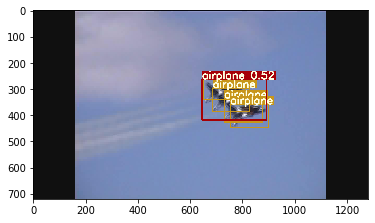

ILSVRC2015_val_00007042/000000 9918
[0.5731777631233187, 0.5904844845179413]


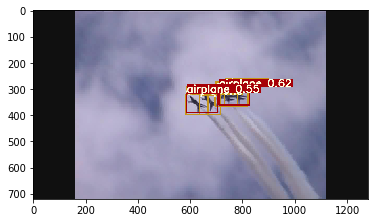

ILSVRC2015_val_00007043/000000 10131
[0.5799160800035732, 0.5904844845179413]


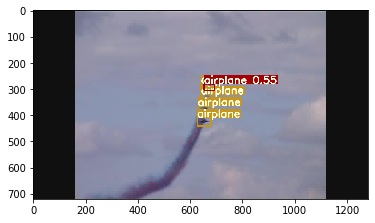

ILSVRC2015_val_00007044/000000 10447
[0.5513690184452786, 0.5904844845179413]


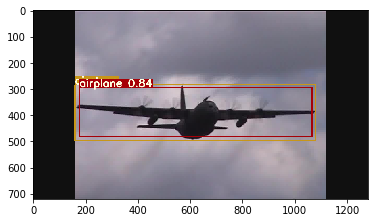

ILSVRC2015_val_00007045/000000 10737
[0.5496550603044453, 0.5904844845179413]


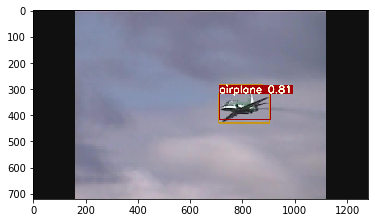

ILSVRC2015_val_00011000/000000 12551
[0.5499607714208506, 0, 0.5904844845179413]


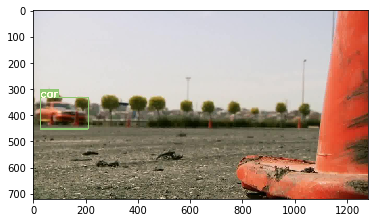

ILSVRC2015_val_00011001/000000 12643
[0.5499607714208506, 0.39704301075268816, 0.5904844845179413]


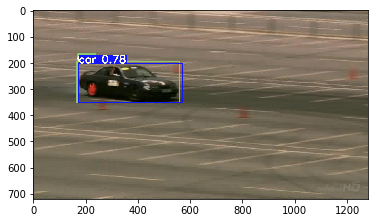

ILSVRC2015_val_00011002/000000 12875
[0.5499607714208506, 0.8141176470588236, 0.5904844845179413]


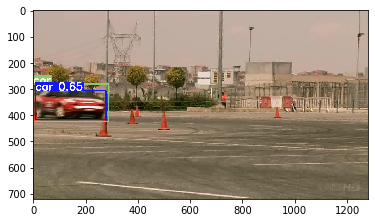

ILSVRC2015_val_00011003/000000 12977
[0.5499607714208506, 0.850056926782514, 0.5904844845179413]


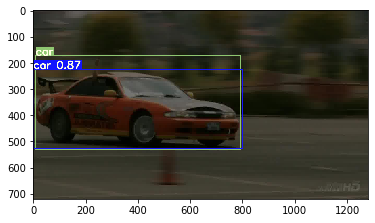

ILSVRC2015_val_00011004/000000 13087
[0.5499607714208506, 0.8778327000895578, 0.5904844845179413]


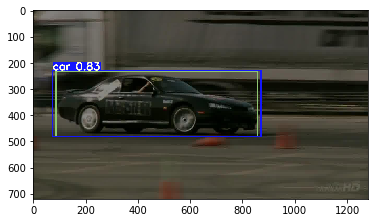

ILSVRC2015_val_00011005/000000 13180
[0.5499607714208506, 0.8361468630408296, 0.5904844845179413]


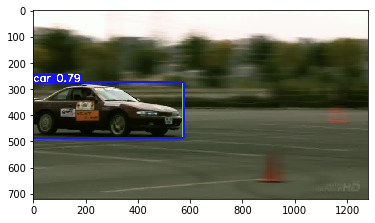

ILSVRC2015_val_00011006/000000 13287
[0.5499607714208506, 0.855518100092044, 0.5904844845179413]


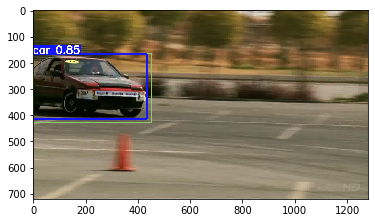

ILSVRC2015_val_00011007/000000 13387
[0.5499607714208506, 0.869415949913547, 0.5904844845179413]


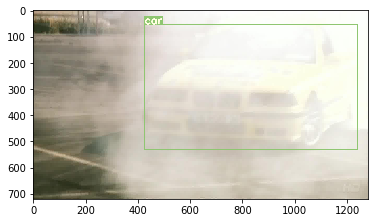

ILSVRC2015_val_00011008/000000 13587
[0.5499607714208506, 0.7314729317439577, 0.5904844845179413]


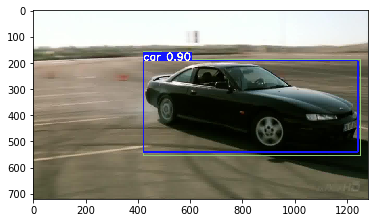

ILSVRC2015_val_00011009/000000 13701
[0.5499607714208506, 0.7558550098433503, 0.5904844845179413]


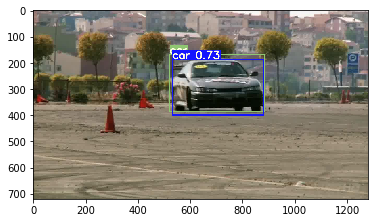

ILSVRC2015_val_00014000/000000 14951
[0.5499607714208506, 1.0, 0.78826452276746, 0.5904844845179413]


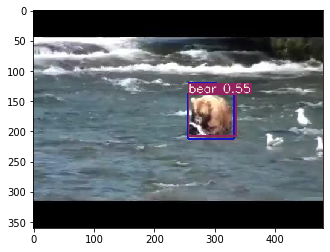

ILSVRC2015_val_00016000/000000 15950
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 1.0, 0.5904844845179413]


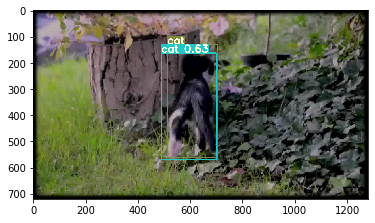

ILSVRC2015_val_00016001/000000 16114
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.6363636363636364, 0.5904844845179413]


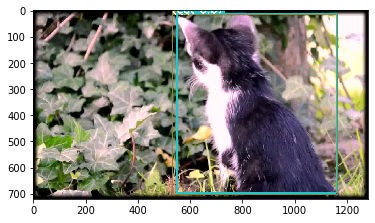

ILSVRC2015_val_00016002/000000 16371
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.7938388625592417, 0.5904844845179413]


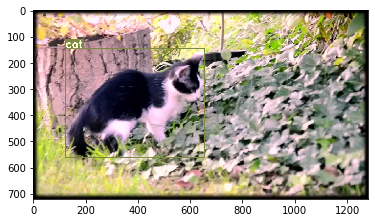

ILSVRC2015_val_00016003/000000 16702
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.8321871748674095, 0.5904844845179413]


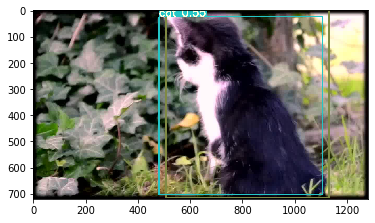

ILSVRC2015_val_00016004/000000 16891
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.8646392739686108, 0.5904844845179413]


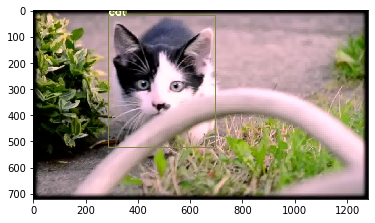

ILSVRC2015_val_00016005/000000 16987
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.7856354490204542, 0.5904844845179413]


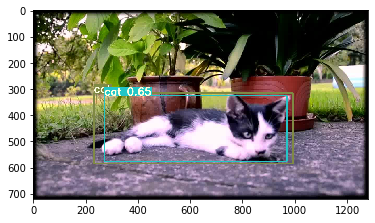

ILSVRC2015_val_00016006/000000 17059
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.7995044538351626, 0.5904844845179413]


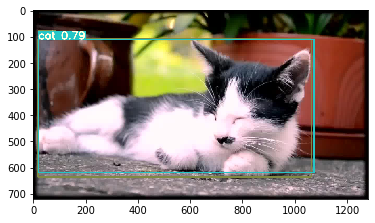

ILSVRC2015_val_00016007/000000 17361
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.8423058443519978, 0.5904844845179413]


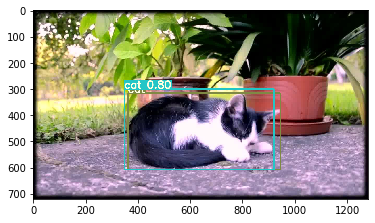

ILSVRC2015_val_00016008/000000 17891
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.8852896102007614, 0.5904844845179413]


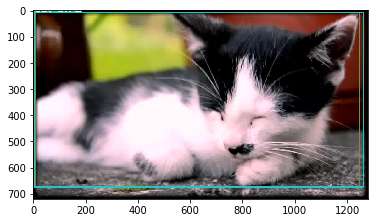

ILSVRC2015_val_00016009/000000 18238
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.9022252150173213, 0.5904844845179413]


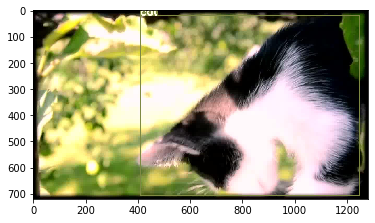

ILSVRC2015_val_00016010/000000 18851
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.8460243970237078, 0.5904844845179413]


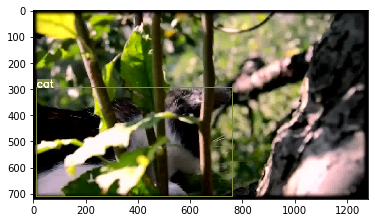

ILSVRC2015_val_00016011/000000 19516
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.7180140361953621, 0.5904844845179413]


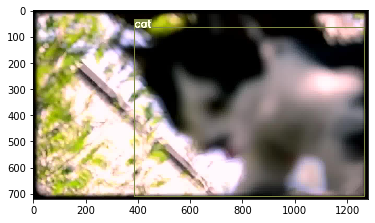

ILSVRC2015_val_00016012/000000 20009
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.7194415308622493, 0.5904844845179413]


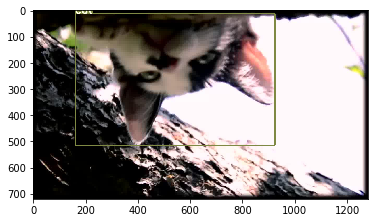

ILSVRC2015_val_00016013/000000 20221
[0.5499607714208506, 0.40804106073567153, 0.78826452276746, 0.6839726875249207, 0.5904844845179413]


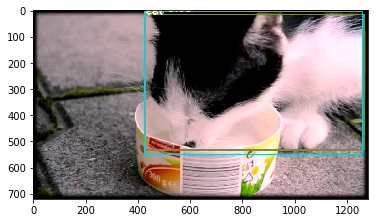

ILSVRC2015_val_00021000/000000 23616
[0.5499607714208506, 0.4076923076923077, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


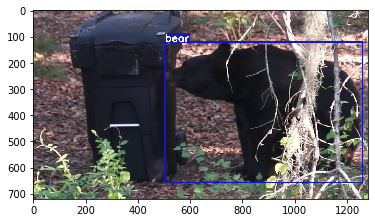

ILSVRC2015_val_00021001/000000 23828
[0.5499607714208506, 0.34546165060243783, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


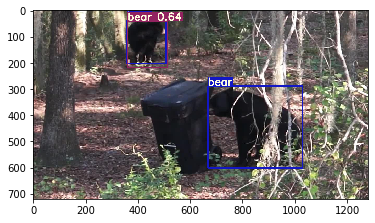

ILSVRC2015_val_00021002/000000 24180
[0.5499607714208506, 0.32322065423867696, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


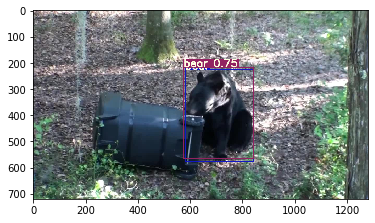

ILSVRC2015_val_00021003/000000 24370
[0.5499607714208506, 0.3263187265610671, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


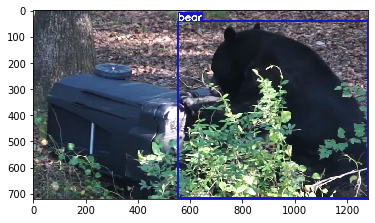

ILSVRC2015_val_00021004/000000 24738
[0.5499607714208506, 0.33575720313716995, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


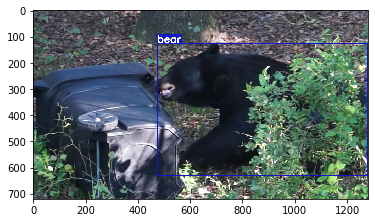

ILSVRC2015_val_00021005/000000 25221
[0.5499607714208506, 0.39943267318631515, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


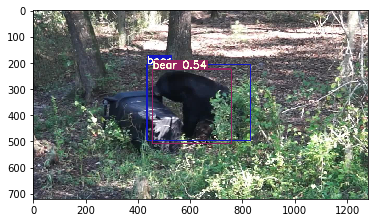

ILSVRC2015_val_00021006/000000 25704
[0.5499607714208506, 0.39674884241689423, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


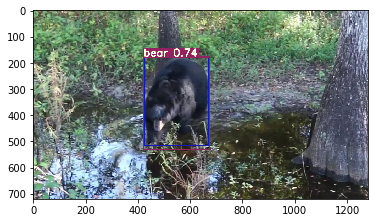

ILSVRC2015_val_00021007/000000 25936
[0.5499607714208506, 0.3966197607551549, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


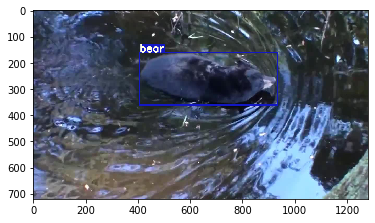

ILSVRC2015_val_00021008/000000 26400
[0.5499607714208506, 0.3567723528989859, 0.78826452276746, 0.7062329503489582, 0.5904844845179413]


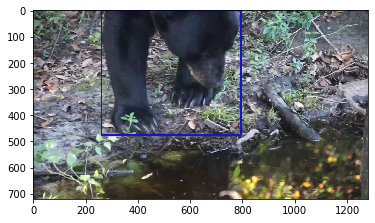

ILSVRC2015_val_00023000/000000 27697
[0.5499607714208506, 0.3547118967828875, 0.0, 0.7867144676194955, 0.7062329503489582, 0.5904844845179413, 1.0]


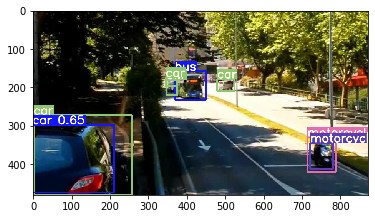

ILSVRC2015_val_00023001/000000 27861
[0.5499607714208506, 0.3547118967828875, 0.6936067997043607, 0.6969350023049803, 0.7062329503489582, 0.5904844845179413, 0.9791666666666665]


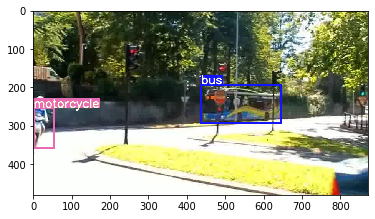

ILSVRC2015_val_00023002/000000 28064
[0.5499607714208506, 0.3547118967828875, 0.6228830111477892, 0.6955213410426984, 0.7062329503489582, 0.5904844845179413, 0.636203585147247]


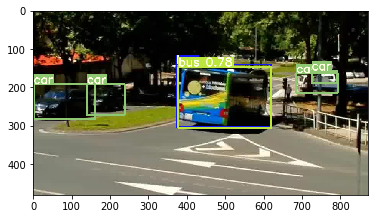

ILSVRC2015_val_00023003/000000 28219
[0.5499607714208506, 0.3547118967828875, 0.5657242102393887, 0.4608763724920032, 0.7062329503489582, 0.5904844845179413, 0.636203585147247]


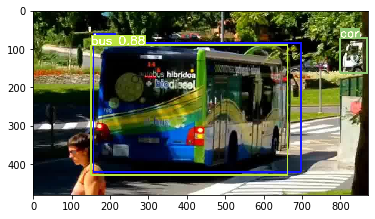

ILSVRC2015_val_00023004/000000 28696
[0.5499607714208506, 0.3547118967828875, 0.7578023039450694, 0.45021621481729035, 0.7062329503489582, 0.5904844845179413, 0.636203585147247]


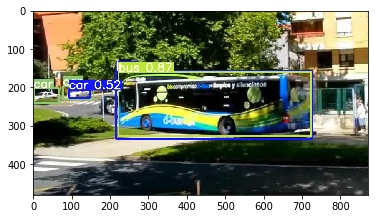

ILSVRC2015_val_00023005/000000 28817
[0.5499607714208506, 0.3547118967828875, 0.7620767517269076, 0.41935117419412016, 0.7062329503489582, 0.5904844845179413, 0.42094673302975755]


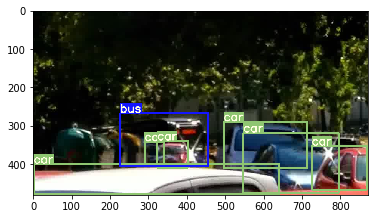

ILSVRC2015_val_00023006/000000 29293
[0.5499607714208506, 0.3547118967828875, 0.6050487770227074, 0.359212408092921, 0.7062329503489582, 0.5904844845179413, 0.42094673302975755]


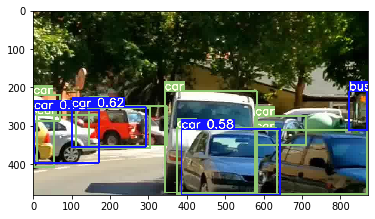

ILSVRC2015_val_00023007/000000 30014
[0.5499607714208506, 0.3547118967828875, 0.5461891916676627, 0.34839870448855115, 0.7062329503489582, 0.5904844845179413, 0.42094673302975755]


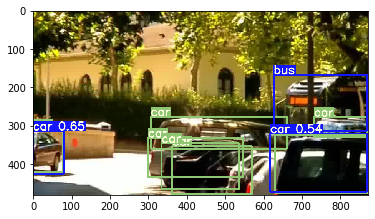

ILSVRC2015_val_00023008/000000 30735
[0.5499607714208506, 0.3547118967828875, 0.5296486558747262, 0.29423190656082043, 0.7062329503489582, 0.5904844845179413, 0.42094673302975755]


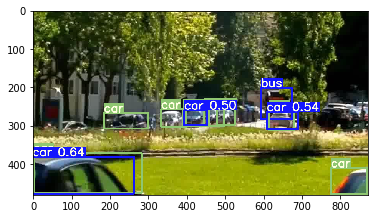

ILSVRC2015_val_00023009/000000 31153
[0.5499607714208506, 0.3547118967828875, 0.4646134471269153, 0.29316873067297766, 0.7062329503489582, 0.5904844845179413, 0.42094673302975755]


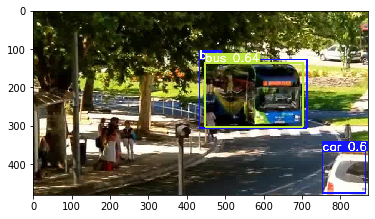

ILSVRC2015_val_00023010/000000 31502
[0.5499607714208506, 0.3547118967828875, 0.5075957339073057, 0.2953204457557689, 0.7062329503489582, 0.5904844845179413, 0.32175813501699857]


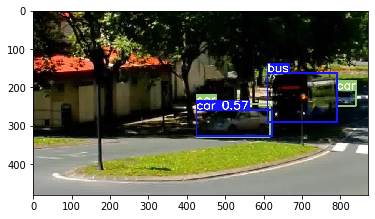

ILSVRC2015_val_00023011/000000 31874
[0.5499607714208506, 0.3547118967828875, 0.4716402518872036, 0.29814436987672227, 0.7062329503489582, 0.5904844845179413, 0.28411106368852845]


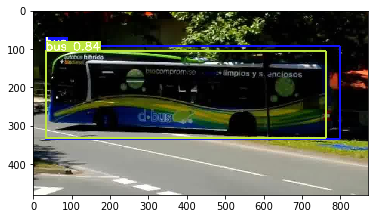

ILSVRC2015_val_00023012/000000 31989
[0.5499607714208506, 0.3547118967828875, 0.4844262132176448, 0.2989028369326009, 0.7062329503489582, 0.5904844845179413, 0.28411106368852845]


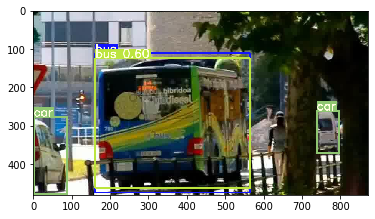

ILSVRC2015_val_00023013/000000 32108
[0.5499607714208506, 0.3547118967828875, 0.4976957319526728, 0.2989081766367948, 0.7062329503489582, 0.5904844845179413, 0.28411106368852845]


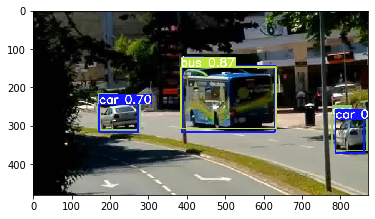

ILSVRC2015_val_00027000/000000 33121
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.016216216216216217]


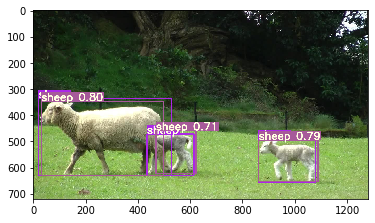

ILSVRC2015_val_00035000/000000 37409
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.0, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


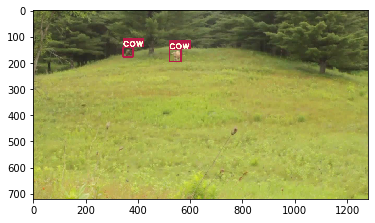

ILSVRC2015_val_00035001/000000 37955
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.0884414938477175, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


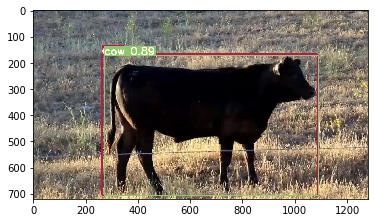

ILSVRC2015_val_00035002/000000 38027
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.11813565731955553, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


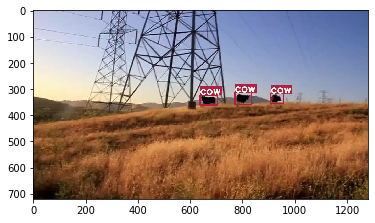

ILSVRC2015_val_00035003/000000 38099
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.109634085418848, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


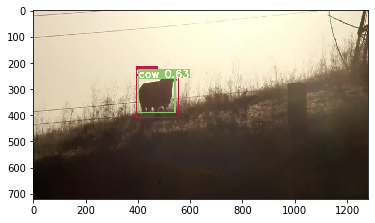

ILSVRC2015_val_00035004/000000 38390
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.14633016332983706, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


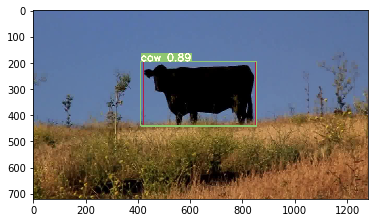

ILSVRC2015_val_00035005/000000 38580
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.20975253238533442, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


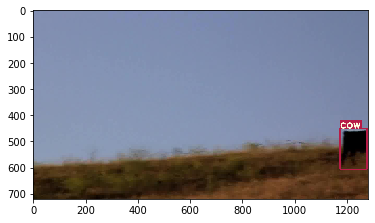

ILSVRC2015_val_00035006/000000 38989
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.26409000018066714, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


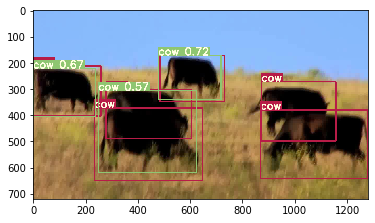

ILSVRC2015_val_00035007/000000 39273
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.41878418568335873, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


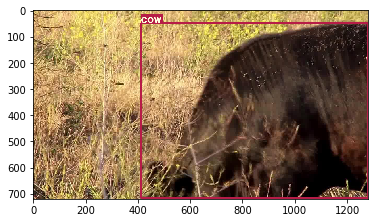

ILSVRC2015_val_00035008/000000 39486
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.30022043477470994, 0.4269647602218787, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


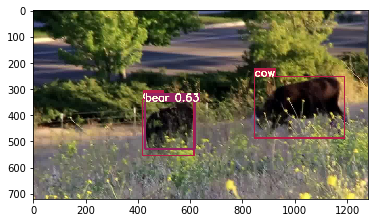

ILSVRC2015_val_00035009/000000 39694
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39395038471029853, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


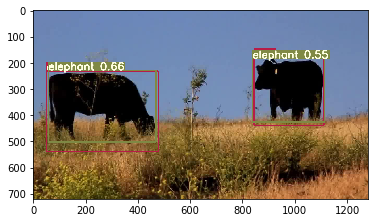

ILSVRC2015_val_00035010/000000 39822
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.3916647319343334, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


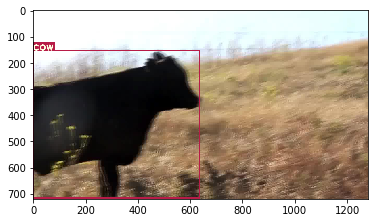

ILSVRC2015_val_00035011/000000 39970
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.3969250123863742, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


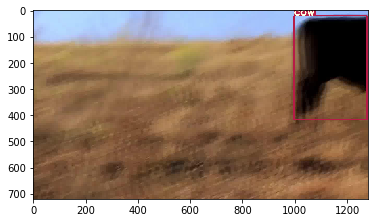

ILSVRC2015_val_00035012/000000 40058
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.4012463960516476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


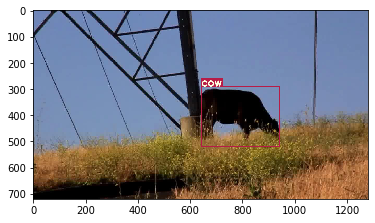

ILSVRC2015_val_00035013/000000 40191
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39692704354469066, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


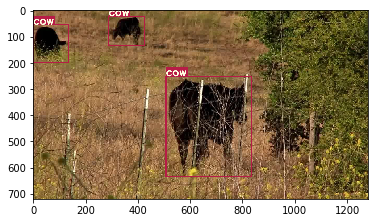

ILSVRC2015_val_00035014/000000 40331
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.38485250744120003, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


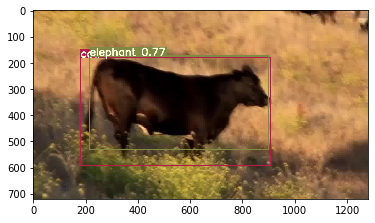

ILSVRC2015_val_00035015/000000 40472
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.393403642131222, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


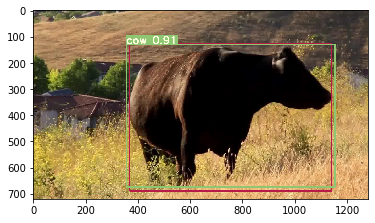

ILSVRC2015_val_00035016/000000 40616
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39441335358312557, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267]


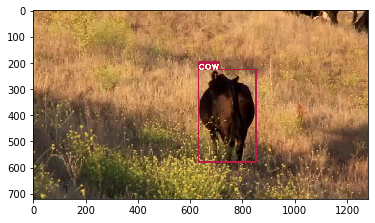

ILSVRC2015_val_00039000/000000 46251
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.00847457627118644]


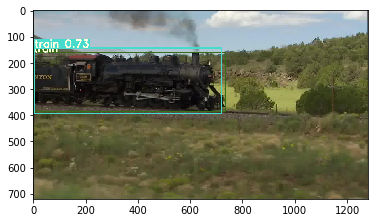

ILSVRC2015_val_00039001/000000 46579
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.7303644001229467]


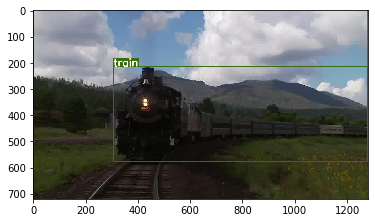

ILSVRC2015_val_00039002/000000 46817
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8035019250039553]


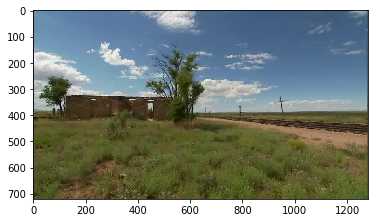

ILSVRC2015_val_00039003/000000 47276
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.6593956756890366]


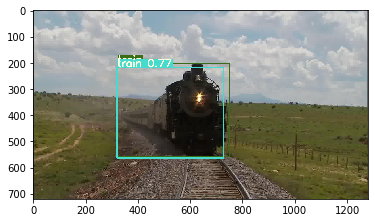

ILSVRC2015_val_00039004/000000 47546
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.702297680855908]


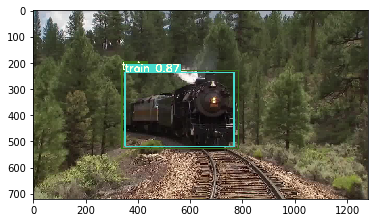

ILSVRC2015_val_00039005/000000 47875
[0.5499607714208506, 0.3547118967828875, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.7581955138320742]


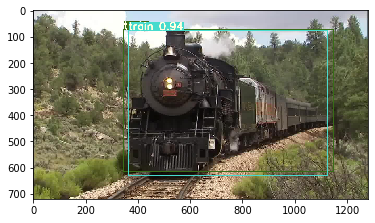

ILSVRC2015_val_00041000/000000 48841
[0.5499607714208506, 0.3547118967828875, 0, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


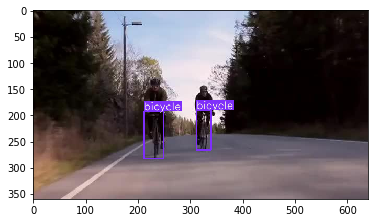

ILSVRC2015_val_00041001/000000 48934
[0.5499607714208506, 0.3547118967828875, 0.14893617021276598, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


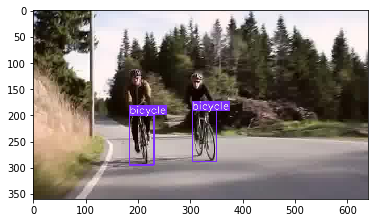

ILSVRC2015_val_00041002/000000 49030
[0.5499607714208506, 0.3547118967828875, 0.12105263157894737, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


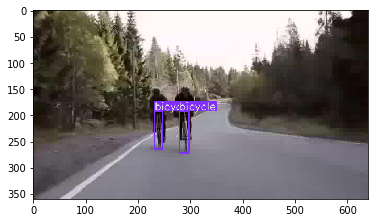

ILSVRC2015_val_00041003/000000 49228
[0.5499607714208506, 0.3547118967828875, 0.05935483870967742, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


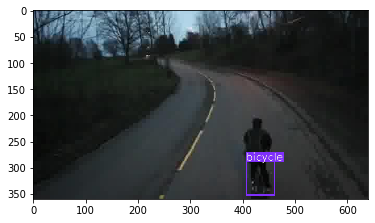

ILSVRC2015_val_00041004/000000 49314
[0.5499607714208506, 0.3547118967828875, 0.0465587044534413, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


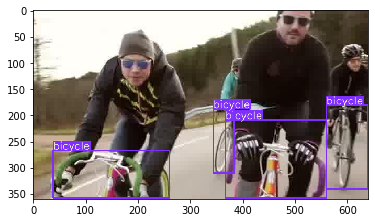

ILSVRC2015_val_00041005/000000 49610
[0.5499607714208506, 0.3547118967828875, 0.268843778021344, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


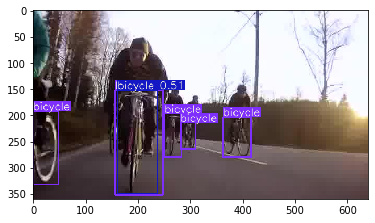

ILSVRC2015_val_00041006/000000 49705
[0.5499607714208506, 0.3547118967828875, 0.2689659474697593, 0.5040387078528746, 0.2997965143641272, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


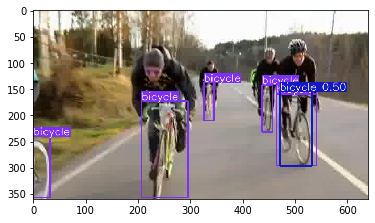

ILSVRC2015_val_00041007/000000 49997
[0.5499607714208506, 0.3547118967828875, 0.31704240038724224, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


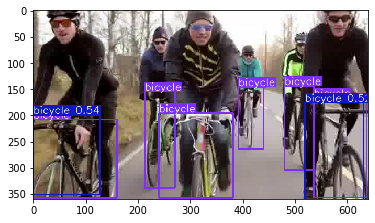

ILSVRC2015_val_00041008/000000 50044
[0.5499607714208506, 0.3547118967828875, 0.3173397138953864, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


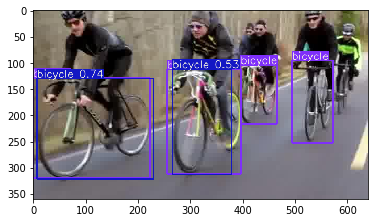

ILSVRC2015_val_00041009/000000 50240
[0.5499607714208506, 0.3547118967828875, 0.3649344437451742, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


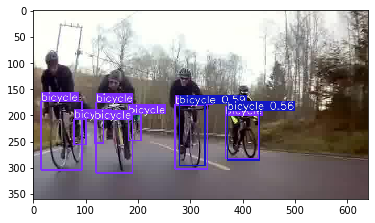

ILSVRC2015_val_00041010/000000 50339
[0.5499607714208506, 0.3547118967828875, 0.369019425014667, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


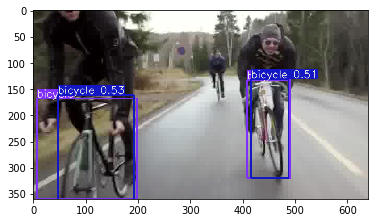

ILSVRC2015_val_00041011/000000 50485
[0.5499607714208506, 0.3547118967828875, 0.38489714513023154, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


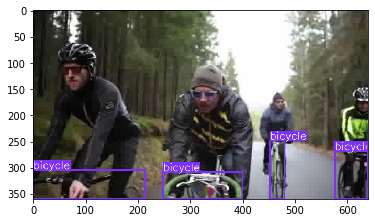

ILSVRC2015_val_00041012/000000 50557
[0.5499607714208506, 0.3547118967828875, 0.3766463144690031, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


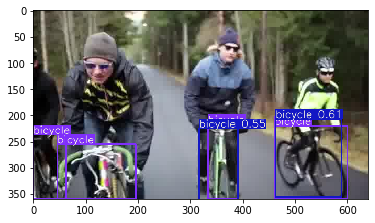

ILSVRC2015_val_00041013/000000 50787
[0.5499607714208506, 0.3547118967828875, 0.3941164673936422, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2385665420285353, 0.719549678184267, 0.8014883088104438]


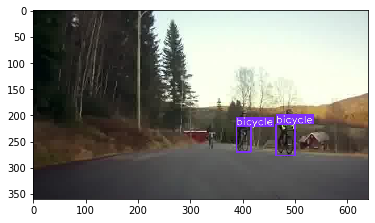

ILSVRC2015_val_00042000/000000 50971
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2376594449105561, 0.719549678184267, 0.8014883088104438]


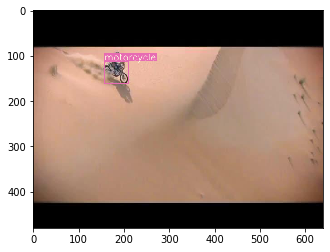

ILSVRC2015_val_00042001/000000 51000
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2161808369241323, 0.719549678184267, 0.8014883088104438]


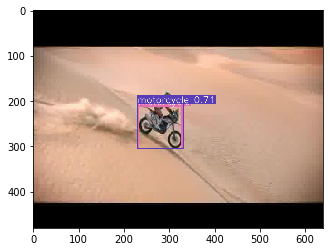

ILSVRC2015_val_00042002/000000 51024
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2491892228069302, 0.719549678184267, 0.8014883088104438]


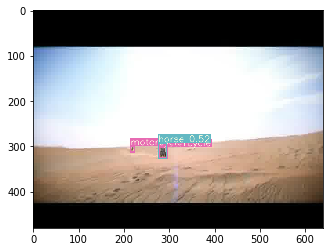

ILSVRC2015_val_00042003/000000 51066
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.21374181493428068, 0.719549678184267, 0.8014883088104438]


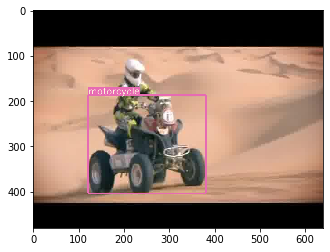

ILSVRC2015_val_00042004/000000 51103
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.21319633908184663, 0.719549678184267, 0.8014883088104438]


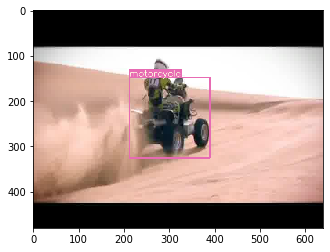

ILSVRC2015_val_00042005/000000 51116
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.20648903852646264, 0.719549678184267, 0.8014883088104438]


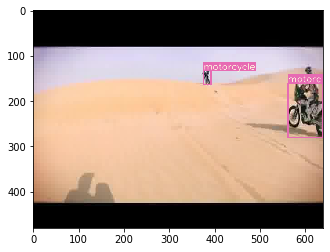

ILSVRC2015_val_00042006/000000 51146
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.18987734922911956, 0.719549678184267, 0.8014883088104438]


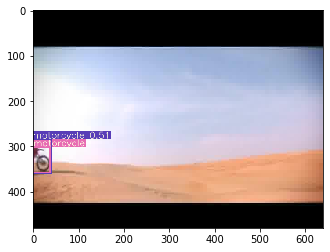

ILSVRC2015_val_00042007/000000 51163
[0.5499607714208506, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.1903528403705298, 0.719549678184267, 0.8014883088104438]


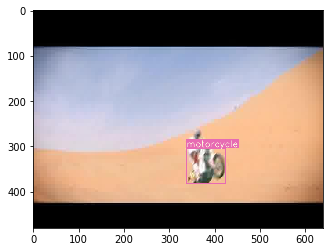

ILSVRC2015_val_00042008/000000 51243
[0.5499362797365299, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.21774548525722237, 0.719549678184267, 0.8014883088104438]


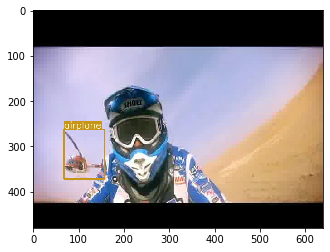

ILSVRC2015_val_00042009/000000 51264
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2173831799572935, 0.719549678184267, 0.8014883088104438]


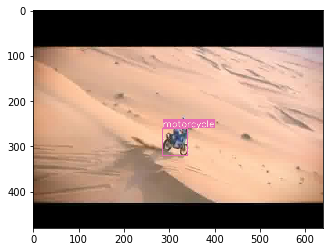

ILSVRC2015_val_00042010/000000 51304
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.20381792691783684, 0.719549678184267, 0.8014883088104438]


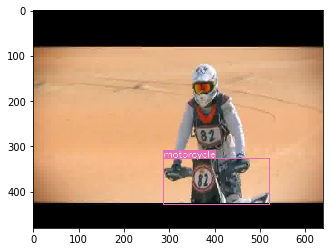

ILSVRC2015_val_00042011/000000 51330
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.19587300023138443, 0.719549678184267, 0.8014883088104438]


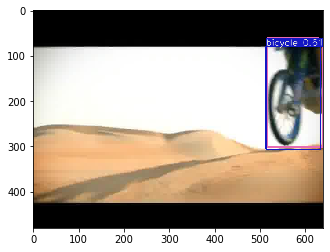

ILSVRC2015_val_00042012/000000 51350
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.20010025976116552, 0.719549678184267, 0.8014883088104438]


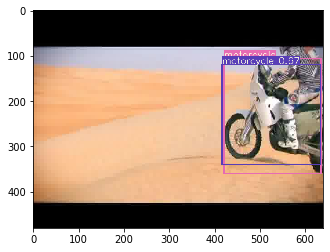

ILSVRC2015_val_00042013/000000 51370
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019181385236992, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.21779327276880034, 0.719549678184267, 0.8014883088104438]


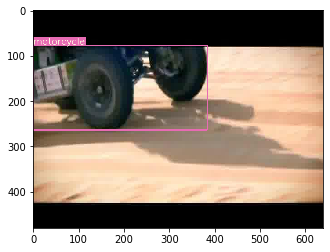

ILSVRC2015_val_00042014/000000 51398
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.3019011901606969, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.22182478833977864, 0.719549678184267, 0.8014883088104438]


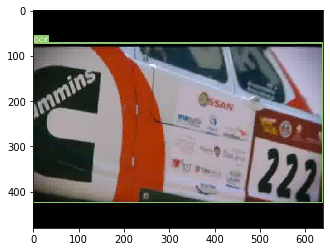

ILSVRC2015_val_00042015/000000 51436
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30125855935036155, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.22256185106512977, 0.719549678184267, 0.8014883088104438]


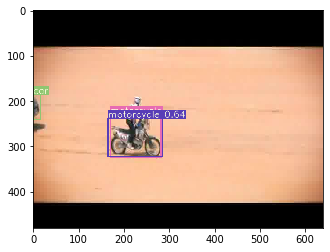

ILSVRC2015_val_00042016/000000 51461
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.2302448048138619, 0.719549678184267, 0.8014883088104438]


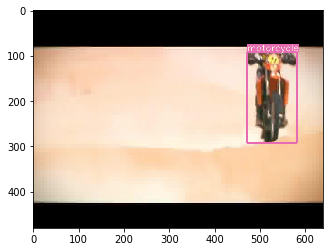

ILSVRC2015_val_00042017/000000 51488
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.22234568190411066, 0.719549678184267, 0.8014883088104438]


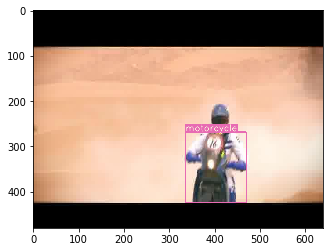

ILSVRC2015_val_00042018/000000 51515
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.22615244775781526, 0.719549678184267, 0.8014883088104438]


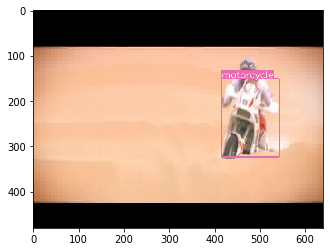

ILSVRC2015_val_00042019/000000 51544
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.7062329503489582, 0.5904844845179413, 0.21837258893815134, 0.719549678184267, 0.8014883088104438]


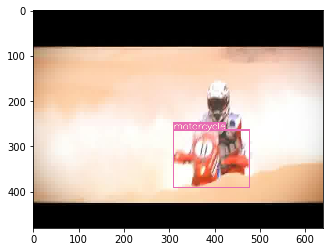

ILSVRC2015_val_00044000/000000 53214
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.0, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


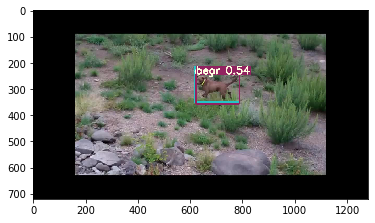

ILSVRC2015_val_00044001/000000 53633
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.005318006016330039, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


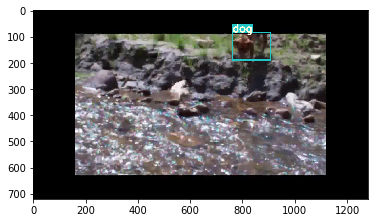

ILSVRC2015_val_00044002/000000 53927
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.007006854531607007, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


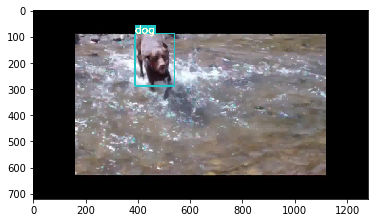

ILSVRC2015_val_00044003/000000 54037
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.008557091293247646, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


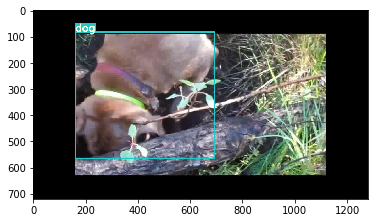

ILSVRC2015_val_00044004/000000 54423
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.006349178700203799, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


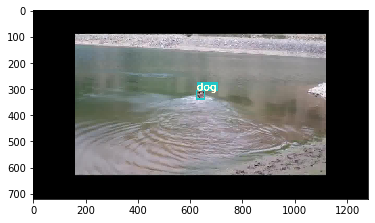

ILSVRC2015_val_00044005/000000 54669
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.004819062067734592, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


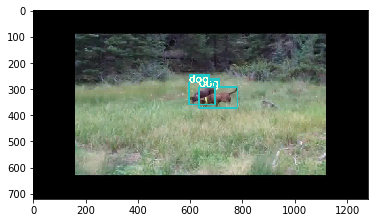

ILSVRC2015_val_00044006/000000 54861
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.008260280026136779, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


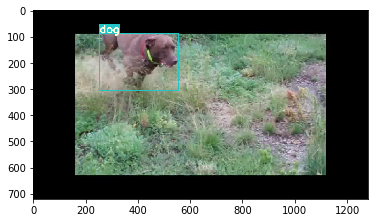

ILSVRC2015_val_00044007/000000 55066
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.007555799287085276, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


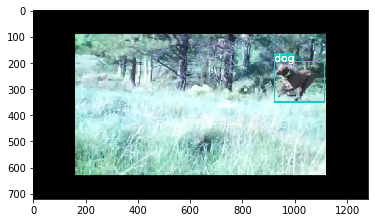

ILSVRC2015_val_00044008/000000 55131
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.007371856607811667, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


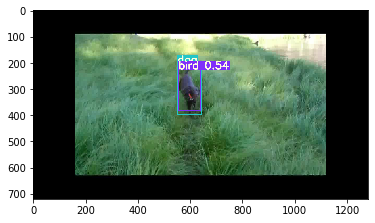

ILSVRC2015_val_00044009/000000 55216
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.007144412756028001, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


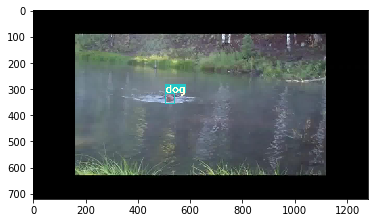

ILSVRC2015_val_00044010/000000 55981
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.05388169001890335, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


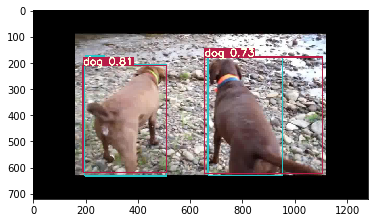

ILSVRC2015_val_00044011/000000 56276
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.06537419220346048, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


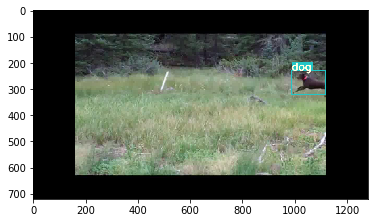

ILSVRC2015_val_00044012/000000 56500
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.06134557236979787, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


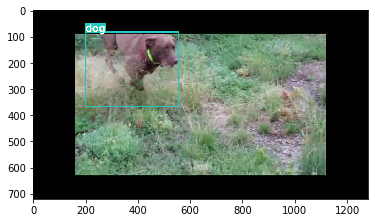

ILSVRC2015_val_00044013/000000 56638
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.06191981675870828, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


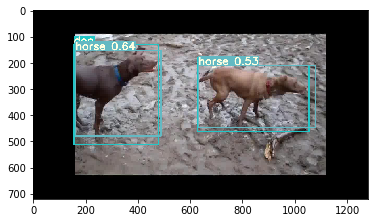

ILSVRC2015_val_00044014/000000 56724
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.06680948146893856, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


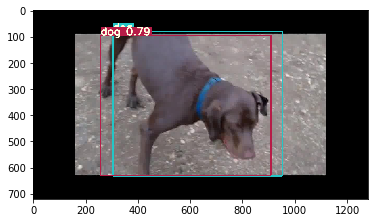

ILSVRC2015_val_00044015/000000 56863
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.08226725419759573, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


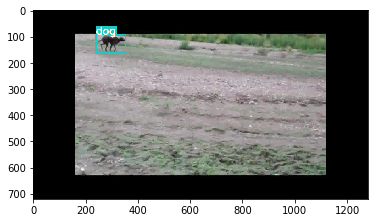

ILSVRC2015_val_00044016/000000 56958
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.08371701404935761, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


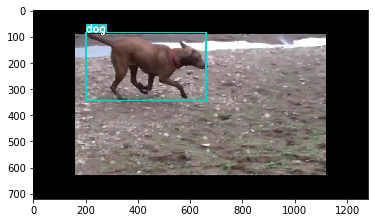

ILSVRC2015_val_00044017/000000 57227
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07838915754569392, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


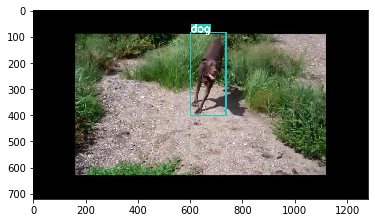

ILSVRC2015_val_00044018/000000 57250
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07805341255061926, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


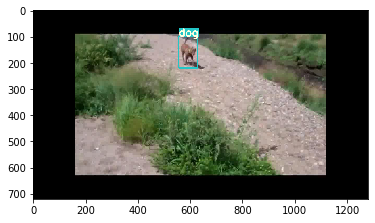

ILSVRC2015_val_00044019/000000 57314
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07729496000843347, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


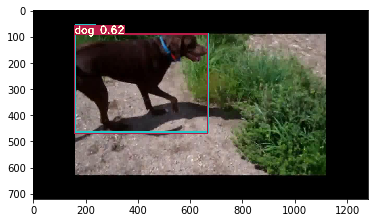

ILSVRC2015_val_00044020/000000 57386
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07930860002741968, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


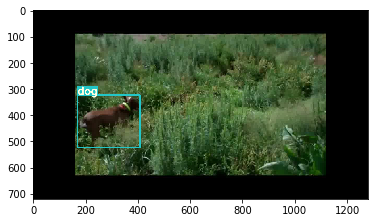

ILSVRC2015_val_00044021/000000 57724
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07478560571176104, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


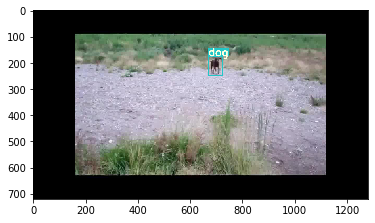

ILSVRC2015_val_00044022/000000 57810
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07550169076153247, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


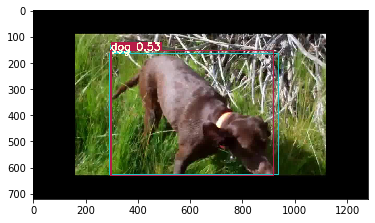

ILSVRC2015_val_00044023/000000 58383
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07597484627648077, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


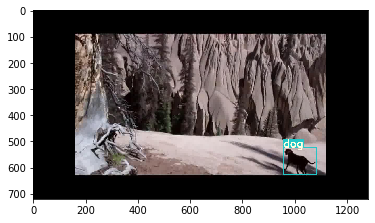

ILSVRC2015_val_00044024/000000 58535
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07342248012765881, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


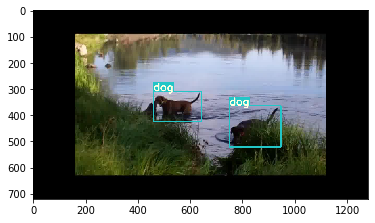

ILSVRC2015_val_00044025/000000 58705
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30085409496098986, 0.39057109803530476, 0.07047938493266825, 0.7062329503489582, 0.5904844845179413, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


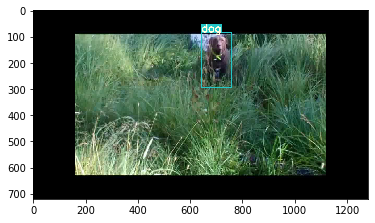

ILSVRC2015_val_00047000/000000 59969
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.5040387078528746, 0.30088179677950594, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.0014245014245014246, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


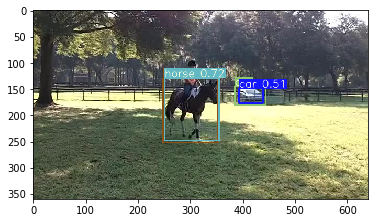

ILSVRC2015_val_00048000/000000 62867
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.0005851375073142189, 0.5040387078528746, 0.30864676810015135, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


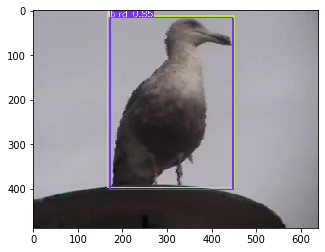

ILSVRC2015_val_00048001/000000 63213
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.12406558958283095, 0.5040387078528746, 0.30864676810015135, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


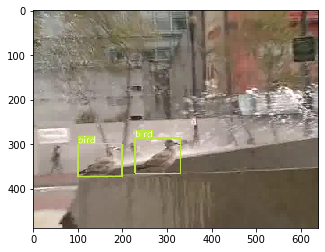

ILSVRC2015_val_00048002/000000 63373
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.12556857186795972, 0.5040387078528746, 0.30864676810015135, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


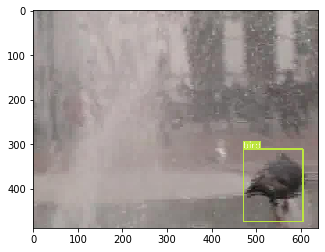

ILSVRC2015_val_00048003/000000 63668
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.15242216503063294, 0.5040387078528746, 0.3033469738421535, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


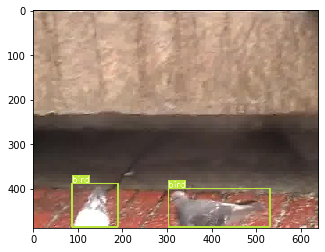

ILSVRC2015_val_00048004/000000 63779
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.1358998405009452, 0.5040387078528746, 0.3033469738421535, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


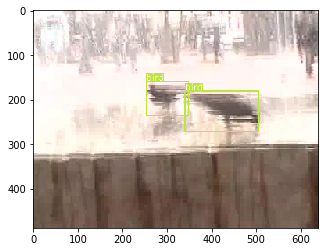

ILSVRC2015_val_00048005/000000 64193
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.15612211862211867, 0.5040387078528746, 0.3033469738421535, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


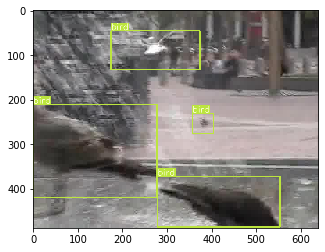

ILSVRC2015_val_00048006/000000 64218
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.1517488024406688, 0.5040387078528746, 0.3033469738421535, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


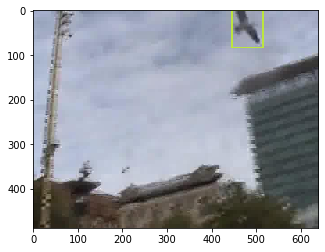

ILSVRC2015_val_00048007/000000 64289
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.14810003347552755, 0.5040387078528746, 0.3033469738421535, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


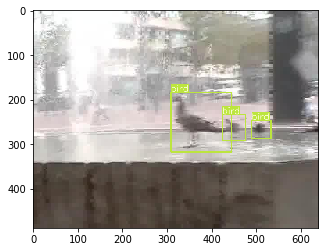

ILSVRC2015_val_00048008/000000 64669
[0.5494469037367644, 0.3547118967828875, 0.3766274184449151, 0.1135146936712198, 0.5040387078528746, 0.3033469738421535, 0.39057109803530476, 0.0693287806960807, 0.7062329503489582, 0.5904844845179413, 0.21771807471826898, 0.2158125351405178, 0.719549678184267, 0.8014883088104438]


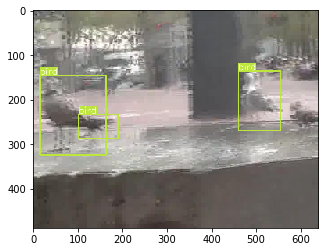

0.4223480360558998
12.63211200476616


In [12]:
data_dir = '../../data/ILSVRC2015/Data/VID/val/'
val_file = '../../data/ILSVRC2015/ImageSets/VID/my_val.txt'


conf_thres = 0.5
iou_thres = 0.5
tracking_threshold = 0.5
max_interval = 12

total_frames = 0
detect_frames = 0


with open(val_file, 'r') as f:
    img_list = f.read().splitlines()
    
    tp_list = []
    conf_list = []
    cls_pred_list = []
    cls_gt_list = []
    
    for idx, img_id in enumerate(img_list):
        frame_i = int(img_id.split(' ')[0].split('/')[-1])
        img = data_dir + img_id.split(' ')[0] + '.JPEG'
        label = img.replace('Data', 'Annotations').replace('.JPEG', '.xml')
        
        frame = cv2.imread(img)
        boxes_gt = parse_bbox(label, id2idx)
        
            
        # Scheduling
        if frame_i == 0:
            boxes = []
            trackers = []
            keyframe = False
            detect = True
            detect_interval = max_interval
            
        elif last_detect < detect_interval:
            img0 = data_dir + img_list[idx-1].split(' ')[0] + '.JPEG'
            label0 = img0.replace('Data', 'Annotations').replace('.JPEG', '.xml')
            boxes0 = parse_bbox(label0, id2idx)
            keyframe = False # len(boxes_gt) != len(boxes0)
            detect = keyframe
            
        else:
            keyframe = False
            detect = True
        
        
        # Tracking
        track = True
        if track:
            for i in range(len(boxes)):
                peak_value, box = trackers[i].update(frame[:,:,::-1])
                x1, y1, x2, y2 = from_tracking_box(box)
                boxes[i][-2] = peak_value
                boxes[i][:4] = np.array([x1, y1, x2, y2])
                if peak_value < tracking_threshold:
                    keyframe = False
                    detect = True
        
        
        if keyframe:
            detect_interval = 2
        elif detect:
            detect_interval = detect_interval*2 if detect_interval*2 < max_interval else max_interval

            
        detect = frame_i % 13 == 0
        # detect_interval = max_interval
        
        total_frames += 1
        detect_frames += detect
        last_detect = 1 if detect else last_detect + 1
            
            
        # Detection
        if detect:
            boxes_new = [] 
            ret = detector.run(frame)['results']
            for j in range(1, opt.num_classes+1):
                for bbox in ret[j]:
                    boxes_new.append(np.append(bbox, j-1))
            boxes_new.sort(key=lambda x: -x[4])
                            
            boxes = update_bbox(boxes, boxes_new, conf_thres, track, coco2imgnet, valid_classes)
                
            if track:
                trackers = []
                for box in boxes:
                    trackers.append(kcftracker.KCFTracker(False, True, True))
                    trackers[-1].init(to_tracking_box(box[:4]), frame[:,:,::-1])
                    #trackers.append(TrackerSiamFC(net_path='model.pth'))
                    #trackers[-1].init(frame[:,:,::-1], to_tracking_box(box[:4]))
    
                
        # Evaluation
        tp_list += get_tp(boxes, boxes_gt, iou_thres)
        conf_list += [b[4] for b in boxes]
        cls_pred_list += [b[-1] for b in boxes]
        cls_gt_list += [b[-1] for b in boxes_gt]

        if frame_i == 0:
            print(img_id)
            
            mAP = compute_mAP(tp_list, conf_list, cls_pred_list, cls_gt_list)
            print(mAP)
            
            # Ground truth boxes
            for *xyxy, cls in boxes_gt:
                label = '%s' % (class_names[int(cls)])
                plot_one_box(xyxy, frame, label=label, color=colors[(int(cls)+1) % len(colors)])

            # Predicted boxes
            for x1, y1, x2, y2, conf, *cls_conf, track_score, cls in boxes:
                label = '%s %.2f' % (class_names[int(cls)], conf)
                plot_one_box([x1, y1, x2, y2], frame, label=label, color=colors[int(cls)])
              
            result = Image.fromarray(frame[:,:,::-1])
            fig, ax = plt.subplots(1)
            ax.imshow(result)
            plt.show()
            
print(np.array(mAP).mean())
print(total_frames / detect_frames)

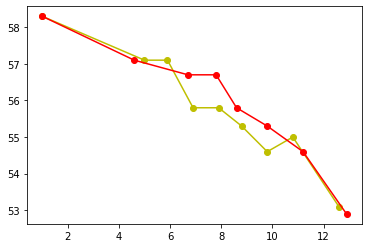

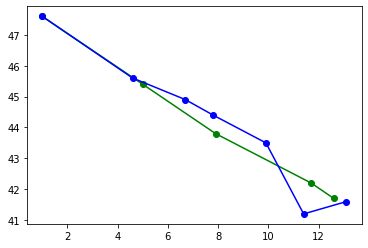

In [26]:
t_yolov3 = [1, 5.0, 5.9, 6.9, 7.9, 8.8, 9.8, 10.8, 12.6]
mAP_yolov3 = [58.3, 57.1, 57.1, 55.8, 55.8, 55.3, 54.6, 55.0, 53.1]

t_yolov3_tracking = [1, 4.6, 6.7, 7.8, 8.6, 9.8, 11.2, 12.9]
mAP_yolov3_tracking = [58.3, 57.1, 56.7, 56.7, 55.8, 55.3, 54.6, 52.9]

t_ctnet = [1, 5.0, 6.9, 7.9, 11.7, 12.6]
mAP_ctnet = [47.6, 45.4, 45.1, 43.8, 42.2, 41.7]

t_ctnet_tracking = [1, 4.6, 6.7, 7.8, 9.9, 11.4, 13.1]
mAP_ctnet_tracking = [47.6, 45.6, 44.9, 44.4, 43.5, 41.2, 41.6]


plt.figure()
plt.plot(t_yolov3, mAP_yolov3, 'oy-')
plt.plot(t_yolov3_tracking, mAP_yolov3_tracking, 'or-')
plt.show()

plt.figure()
plt.plot(t_ctnet, mAP_ctnet, 'og-')
plt.plot(t_ctnet_tracking, mAP_ctnet_tracking, 'ob-')
plt.show()

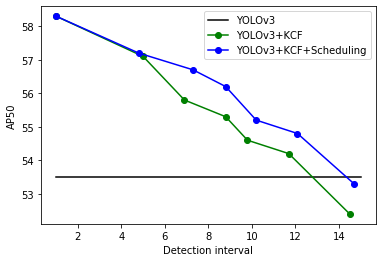

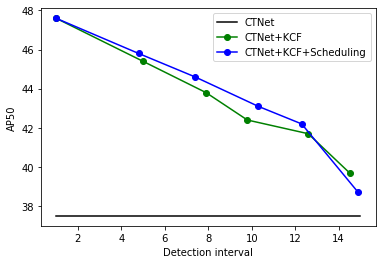

In [61]:
t_yolov3 = [1, 5.0, 6.9, 8.8, 9.8, 11.7, 14.5]
mAP_yolov3 = [58.3, 57.1, 55.8, 55.3, 54.6, 54.2, 52.4]

t_yolov3_tracking = [1, 4.8, 7.3, 8.8, 10.2, 12.1, 14.7]
mAP_yolov3_tracking = [58.3, 57.2, 56.7, 56.2, 55.2, 54.8, 53.3]

t_ctnet = [1, 5.0, 7.9, 9.8, 12.6, 14.5]
mAP_ctnet = [47.6, 45.4, 43.8, 42.4, 41.7, 39.7]

t_ctnet_tracking = [1, 4.8, 7.4, 10.3, 12.3, 14.9]
mAP_ctnet_tracking = [47.6, 45.8, 44.6, 43.1, 42.2, 38.7]


plt.figure()
plt.plot(range(1,16), [53.5]*15, 'k-', label='YOLOv3')
plt.plot(t_yolov3, mAP_yolov3, 'og-', label='YOLOv3+KCF')
plt.plot(t_yolov3_tracking, mAP_yolov3_tracking, 'ob-', label='YOLOv3+KCF+Scheduling')
plt.legend()
plt.xlabel('Detection interval')
plt.ylabel('AP50')
plt.savefig('../../YOLOv3.png')
plt.show()

plt.figure()
plt.plot(range(1,16), [37.5]*15, 'k-', label='CTNet')
plt.plot(t_ctnet, mAP_ctnet, 'og-', label='CTNet+KCF')
plt.plot(t_ctnet_tracking, mAP_ctnet_tracking, 'ob-', label='CTNet+KCF+Scheduling')
plt.legend()
plt.xlabel('Detection interval')
plt.ylabel('AP50')
plt.savefig('../../CTNet.png')
plt.show()